# Load necessary packages
#### Python 3.8.10

In [1]:
import os

from cmcrameri import cm as cm_ref
from matplotlib.lines import Line2D
import matplotlib.pyplot as plt
import nibabel as nib
import numpy as np
import pingouin as pg
from scipy.stats import wilcoxon


# Define the used functions

In [2]:
def p_value_sf(p_value):
    # Determine the significant figures: https://evidence.nejm.org/about/editorial-policies
    if p_value > 0.01:
        return f'p = {p_value:.2f}'
    elif ((p_value <= 0.01) and (p_value >= 0.001)):
        return f'p = {p_value:.3f}'
    else:
        return 'p < 0.001'


# Define the dictionary of sequences

In [3]:
SEQUENCE_DATA = {
    1: 'SG1_CS2_weak_120',
    2: 'SG1_CS2_weak_120_ST',
    3: 'SG1_CS2_weak_160',
    4: 'SG1_CS2_weak_160_ST',
    5: 'SG1_CS2_strong_120',
    6: 'SG1_CS2_strong_120_ST',
    7: 'SG1_CS2_strong_160',
    8: 'SG1_CS2_strong_160_ST',
    9: 'SG03_CS3_weak_120',
    10: 'SG03_CS3_weak_120_ST',
    11: 'SG03_CS3_weak_160',
    12: 'SG03_CS3_weak_160_ST',
    13: 'SG03_CS3_strong_120',
    14: 'SG03_CS3_strong_120_ST',
    15: 'SG03_CS3_strong_160',
    16: 'SG03_CS3_strong_160_ST',
    17: 'SG1_CS3_weak_120',
    18: 'SG1_CS3_weak_120_ST',
    19: 'SG1_CS3_weak_160',
    20: 'SG1_CS3_weak_160_ST',
    21: 'SG1_CS3_strong_120',
    22: 'SG1_CS3_strong_120_ST',
    23: 'SG1_CS3_strong_160',
    24: 'SG1_CS3_strong_160_ST',
}


# Define all paths

In [4]:
DATA_PATH = os.path.join('data_anonymized','MR-Linac','volunteer')

# Define the colormaps, units, and ranges

In [5]:
CMAPS = {
    'T1': cm_ref.lipari,
    'T2': cm_ref.navia,
    'PD': cm_ref.glasgow
}

UNIT_TYPES = {
    'T1': 'ms',
    'T2': 'ms',
    'PD': 'pu'
}

MIN_RANGE = {
    'T1': 250,
    'T2': 10,
    'PD': 0
}
MAX_RANGE = {
    'T1': 4300,
    'T2': 2000,
    'PD': 160
}
MIN_RANGE_CLINICAL = {
    'T1': 250,
    'T2': 30,
    'PD': 20
}
MAX_RANGE_CLINICAL = {
    'T1': 2000,
    'T2': 200,
    'PD': 160
}

# Load the files

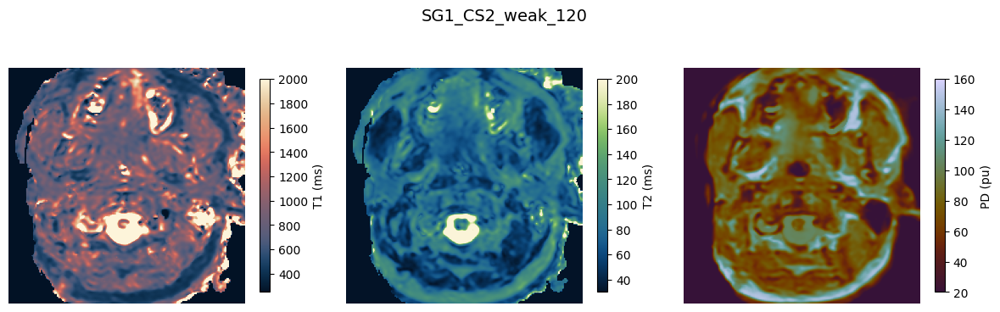

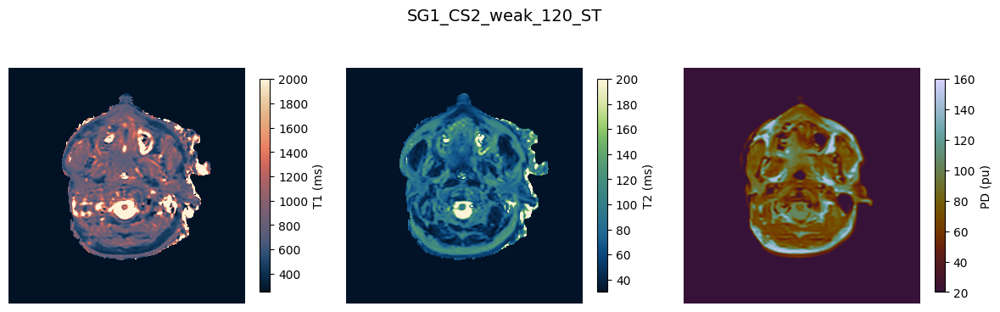

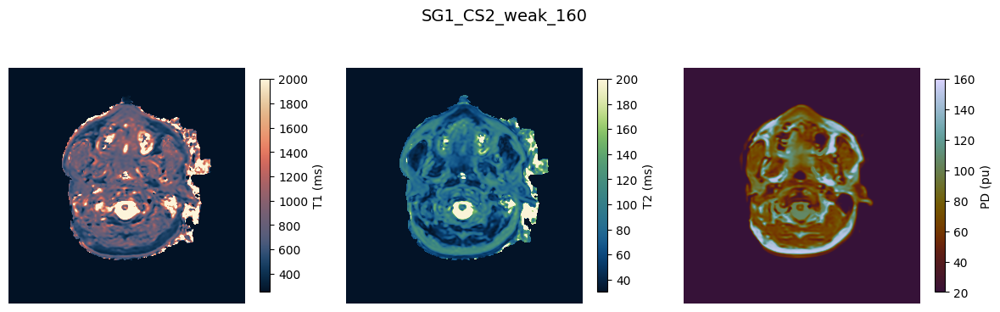

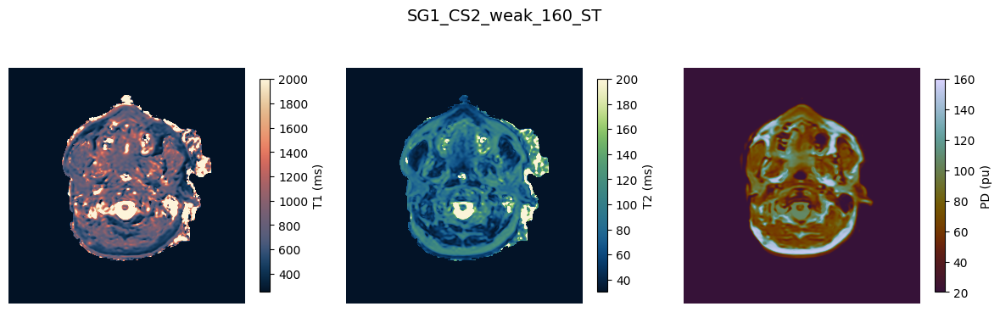

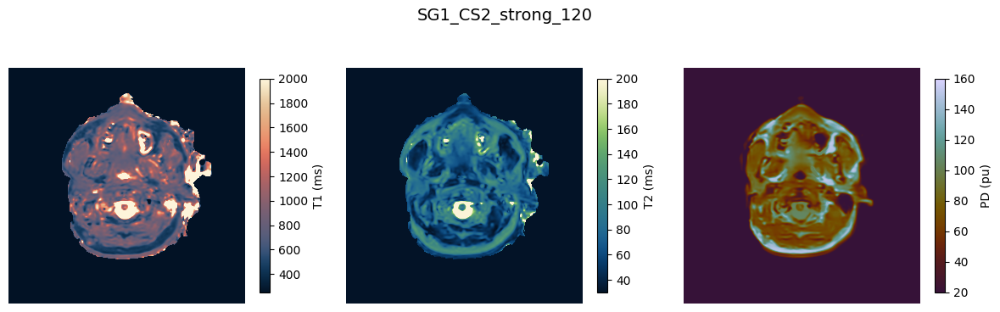

...

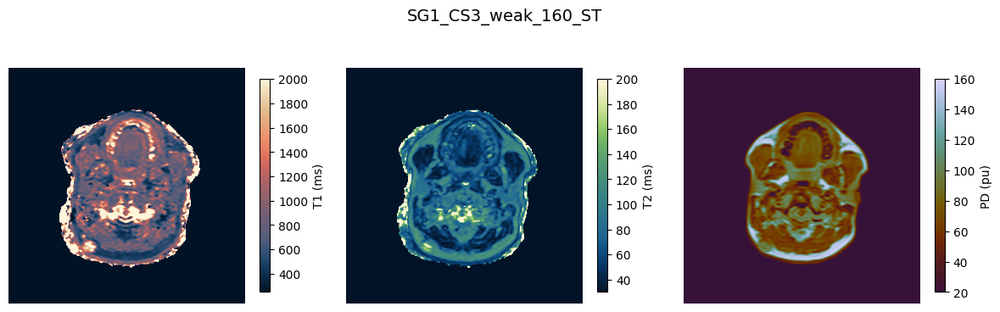

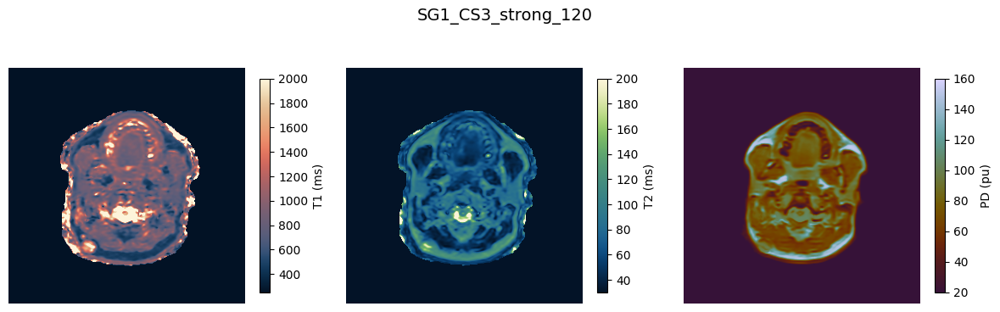

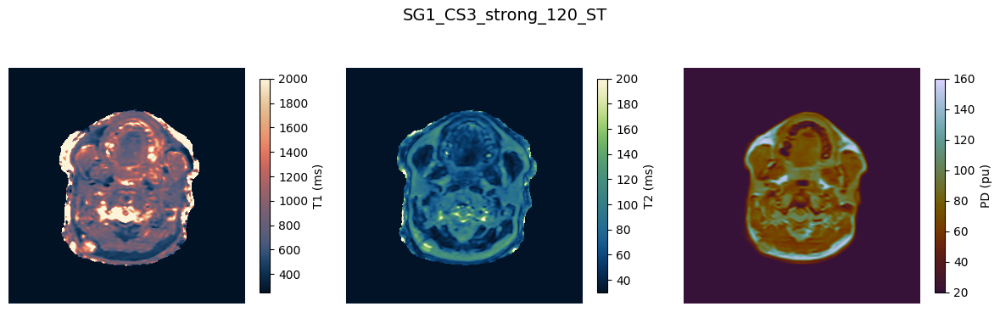

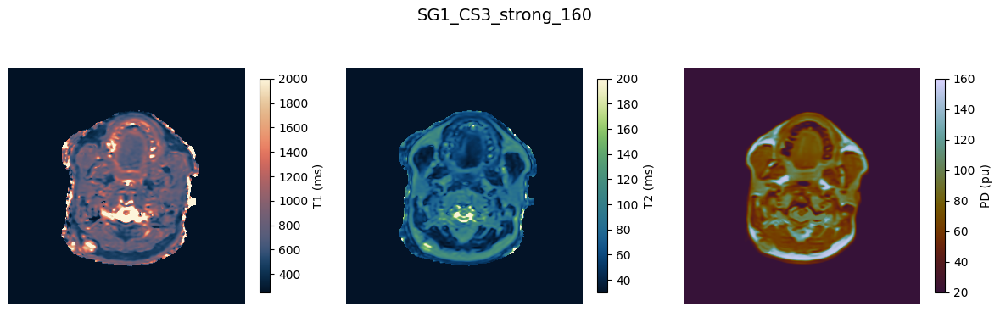

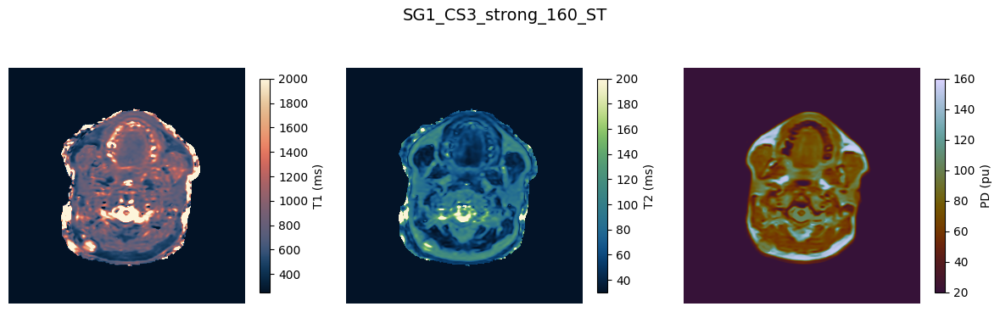

In [6]:
im_types = ['T1','T2','PD']
all_image_data = {}
SHOW_PLOT = True

for sp in sorted(SEQUENCE_DATA.keys()):
    all_image_data[sp] = {}
    all_image_files = {
        im_type: os.path.join(DATA_PATH, str(sp), f'SYMAPS_{im_type}.nii.gz')
        for im_type in im_types
    }

    # Combine all the imaging data into a single array
    for im_type in im_types:
        all_image_data[sp][im_type] = {
            'all': []
        }
        # Read the image file
        temp_img = nib.load(all_image_files[im_type])
        temp_linear = temp_img.get_fdata()
        scl_slope = temp_img.header['scl_slope']
        if np.isnan(scl_slope):
            scl_slope = 1
        scl_inter = temp_img.header['scl_inter']
        if np.isnan(scl_inter):
            scl_inter = 0
        scaled_data = scl_slope*temp_linear + scl_inter
        scaled_data = np.transpose(scaled_data, (2,1,0))
        # Save the data
        all_image_data[sp][im_type]['all'] = scaled_data

    if SHOW_PLOT:
        # Plot the data
        fig,axes = plt.subplots(nrows=1, ncols=3, figsize=(12,4))
        for i,im_type in enumerate(im_types):
            slice_loc = int(all_image_data[sp][im_type]['all'].shape[0] / 2)
            sample_image_mat = all_image_data[sp][im_type]['all'][slice_loc,:,:]
            temp_im = axes[i].imshow(sample_image_mat, vmin=MIN_RANGE_CLINICAL[im_type], vmax=MAX_RANGE_CLINICAL[im_type], cmap=CMAPS[im_type])
            axes[i].axis('off')
            cbar = plt.colorbar(temp_im, shrink=0.75, ax=axes[i])
            cbar.ax.tick_params(labelsize=10)
            cbar.set_label(label=f'{im_type} (pu)' if im_type=='PD' else f'{im_type} (ms)', size=10)
        plt.suptitle(SEQUENCE_DATA[sp], fontsize=14)
        plt.tight_layout()
        plt.show()


# Visualize the segmentations

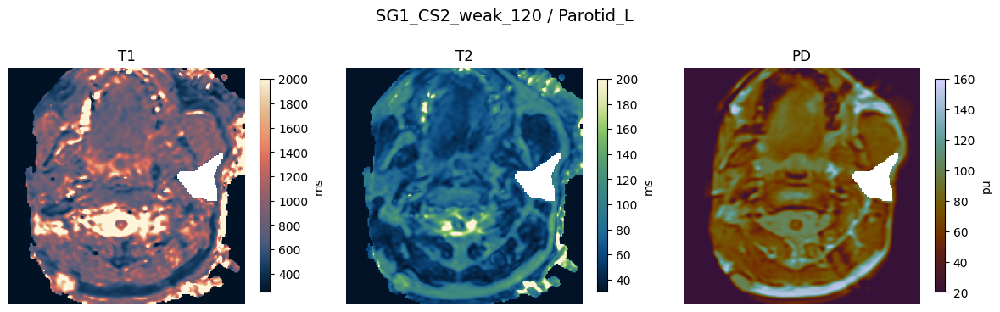

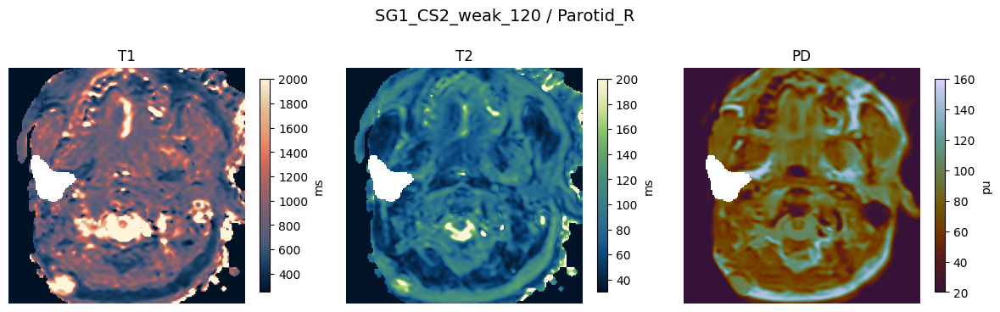

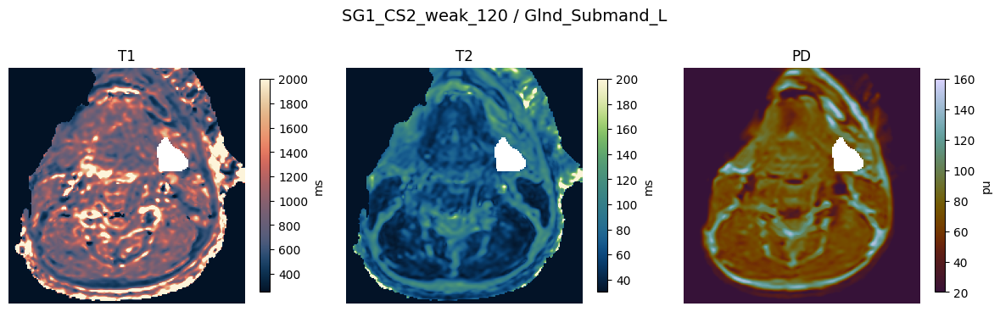

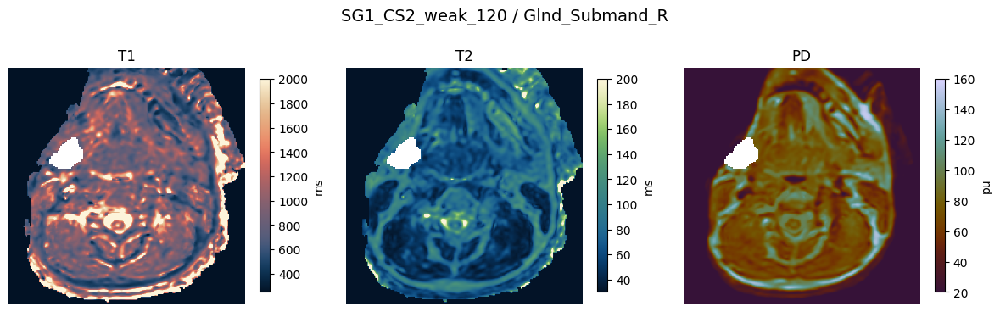

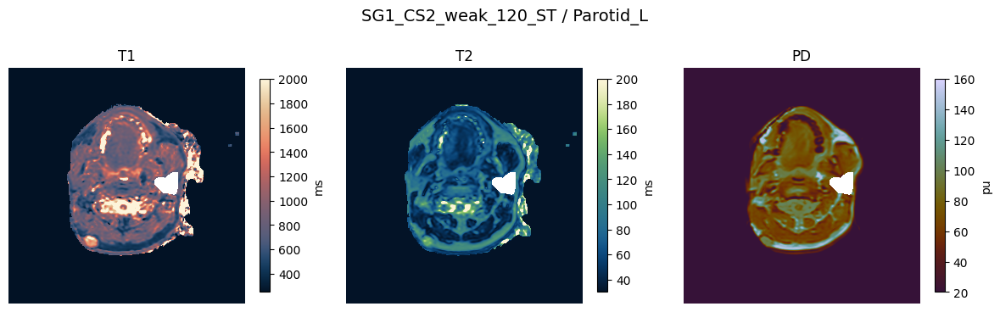

...

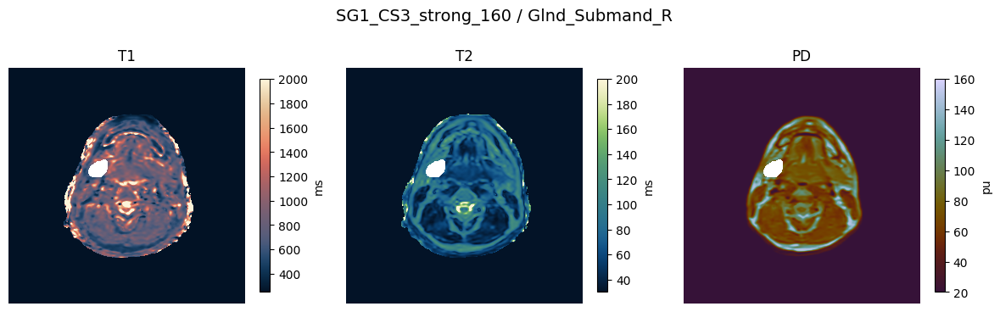

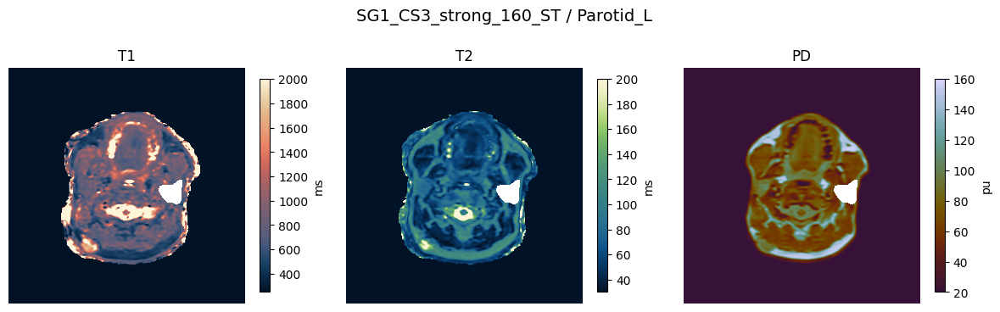

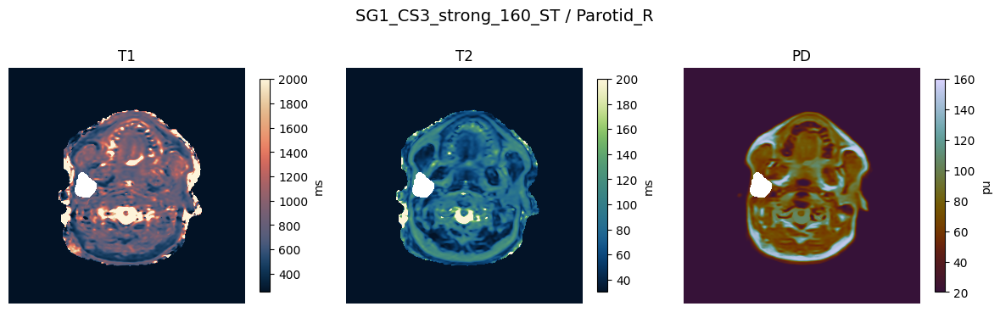

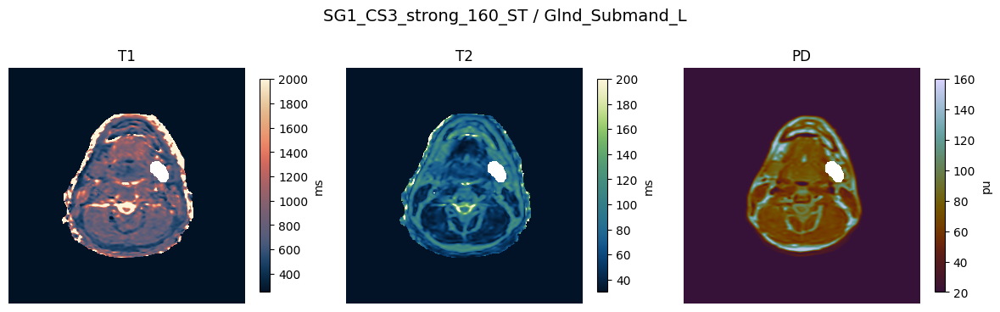

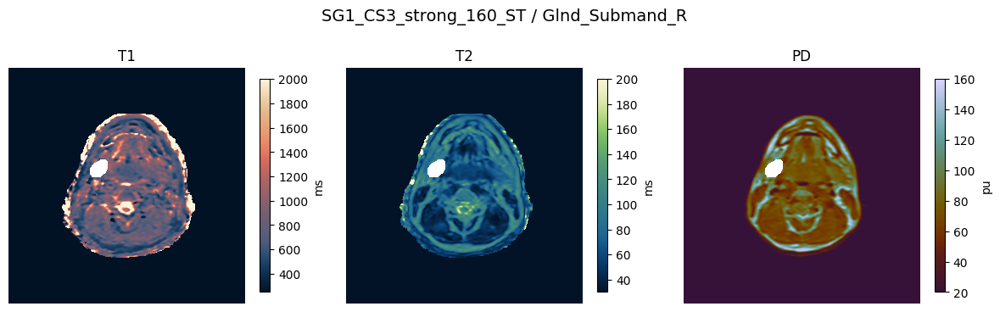

In [7]:
struct_types = [
    'Parotid_L',
    'Parotid_R',
    'Glnd_Submand_L',
    'Glnd_Submand_R'
]
all_struct_data = {}
SHOW_PLOT = True


for sp in sorted(SEQUENCE_DATA.keys()):
    all_struct_data[sp] = {}

    for struct_type in struct_types:
        all_struct_data[sp][struct_type] = {}
        struct_mask = nib.load(os.path.join(DATA_PATH, str(sp), f'{struct_type}.nii'))
        struct_mask = np.transpose(struct_mask.get_fdata(), (2,1,0))
        struct_mask = np.flip(struct_mask, axis=0)
        slice_loc = int(np.median(np.where(struct_mask == 1)[0]))

        if SHOW_PLOT:
            fig,axes = plt.subplots(nrows=1, ncols=3, figsize=(12,4))
        for i,im_type in enumerate(['T1','T2','PD']):
            # Load the SyMap
            current_image_data = all_image_data[sp][im_type]['all']

            # Save the extracted segment with spatial information
            saved_image_mat = np.empty(current_image_data.shape, dtype=np.float64)
            saved_image_mat[:] = np.nan
            saved_nonzero_struct_mask = np.where(struct_mask == 1)
            saved_image_mat[saved_nonzero_struct_mask] = current_image_data[saved_nonzero_struct_mask]
            temp_im_data = saved_image_mat.copy()
            all_image_data[sp][im_type][struct_type] = temp_im_data

            # Extract the values
            temp_im_data = temp_im_data[~np.isnan(temp_im_data)]
            all_struct_data[sp][struct_type][im_type] = {
                'mean': np.nanmean(temp_im_data),
                'median': np.nanmedian(temp_im_data),
                'std': np.nanstd(temp_im_data),
                'cov': 100 * np.nanstd(temp_im_data) / np.nanmean(temp_im_data)
            }

            if SHOW_PLOT:
                # Show where the segment is
                temp_image_mat = current_image_data[slice_loc,:,:].copy()
                temp_image_mat[struct_mask[slice_loc,:,:] == 1] = np.nan
                temp_im = axes[i].imshow(temp_image_mat, vmin=MIN_RANGE_CLINICAL[im_type], vmax=MAX_RANGE_CLINICAL[im_type], cmap=CMAPS[im_type], alpha=1)
                axes[i].axis('off')
                axes[i].set_title(im_type, fontsize=12)
                cbar = plt.colorbar(temp_im, shrink=0.75, ax=axes[i])
                cbar.ax.tick_params(labelsize=10)
                cbar.set_label(label=UNIT_TYPES[im_type], size=10)

        if SHOW_PLOT:
            plt.suptitle(f'{SEQUENCE_DATA[sp]} / {struct_type}', fontsize=14)
            plt.tight_layout()
            plt.show()


# Statistically compare the acquisitions

## 1. Slice Gap

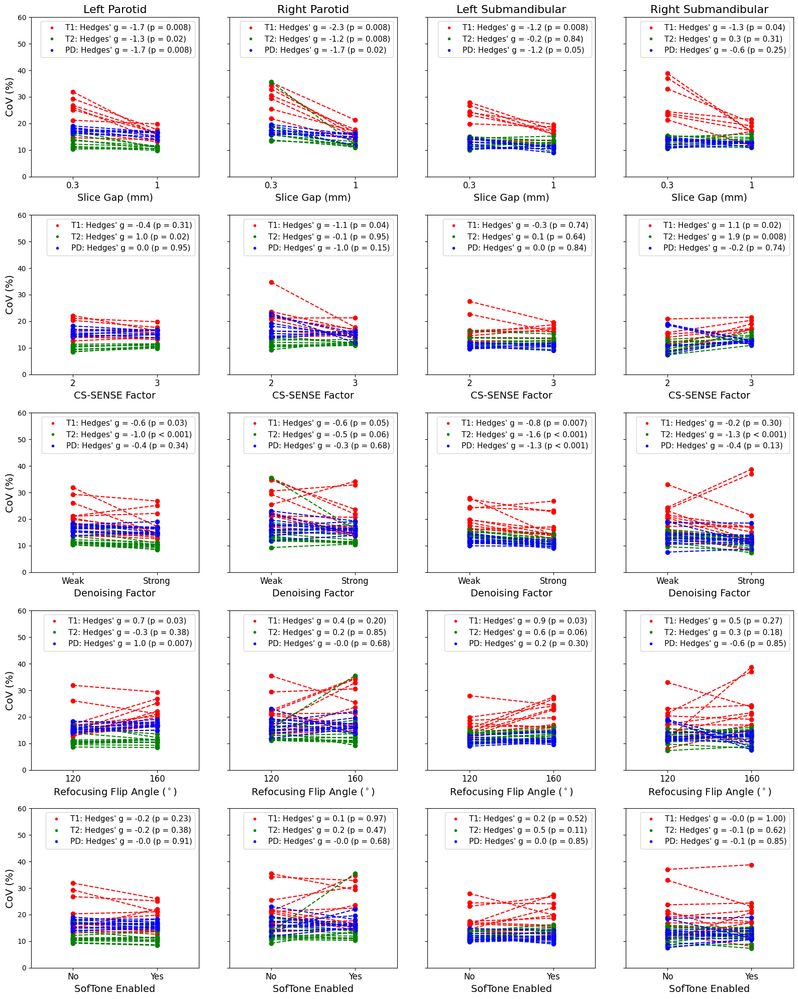

In [8]:
struct_types = [
    'Parotid_L',
    'Parotid_R',
    'Glnd_Submand_L',
    'Glnd_Submand_R'
]
struct_type_labels = [
    'Left Parotid',
    'Right Parotid',
    'Left Submandibular',
    'Right Submandibular'
]
metric = 'cov'
metric_label = 'CoV (%)'
# T1, T2, PD
colors = {
    'T1': 'r',
    'T2': 'g',
    'PD': 'b'
}


fig,ax = plt.subplots(nrows=5, ncols=len(struct_types), sharex=False, sharey=True, figsize=(len(struct_types)*4,5*4))

# Slice gap
for s,struct_type in enumerate(struct_types):
    all_p_value = {}
    all_hedges_g = {}
    for i,im_type in enumerate(['T1','T2','PD']):
        temp_data = ([],[])
        for sp in SEQUENCE_DATA.keys():
            if 'SG03' in SEQUENCE_DATA[sp]:
                ax[0,s].scatter(1, all_struct_data[sp][struct_type][im_type][metric], color=colors[im_type])
                try:
                    other_sp = SEQUENCE_DATA[sp].replace('SG03','SG1')
                    other_sp = list(SEQUENCE_DATA.values()).index(other_sp) + 1
                    ax[0,s].plot([1,2], [all_struct_data[sp][struct_type][im_type][metric], all_struct_data[other_sp][struct_type][im_type][metric]], linestyle='--', color=colors[im_type])
                    ax[0,s].scatter(2, all_struct_data[other_sp][struct_type][im_type][metric], color=colors[im_type])
                    temp_data[0].append(all_struct_data[sp][struct_type][im_type][metric])
                    temp_data[1].append(all_struct_data[other_sp][struct_type][im_type][metric])
                except ValueError:
                    pass
            elif 'SG1' in SEQUENCE_DATA[sp]:
                pass
            ax[0,s].set_xlim([0.5,2.5])
            ax[0,s].set_xticks([1,2])
            ax[0,s].set_xticklabels(['0.3','1'], fontsize=12)
            ax[0,s].set_ylim([0,60])
        _,p_value = wilcoxon(temp_data[0], temp_data[1])
        hedges_g = -pg.compute_effsize(temp_data[0], temp_data[1], paired=True, eftype='hedges')
        all_p_value[im_type] = p_value
        all_hedges_g[im_type] = hedges_g
        ax[0,s].set_title(struct_type_labels[s], fontsize=16)
        ax[0,s].set_xlabel('Slice Gap (mm)', fontsize=14)
        if s == 0:
            ax[0,s].set_ylabel(metric_label, fontsize=14)
    ax[0,s].legend(handles=[
        Line2D([0], [0], marker='o', color='w', label=f"{im_type}: Hedges' g = {all_hedges_g[im_type]:.1f} ({p_value_sf(all_p_value[im_type])})", markerfacecolor=colors[im_type], markersize=5)
        for im_type in im_types
    ], fontsize=11, loc='upper right')


# CS-SENSE factor
for s,struct_type in enumerate(struct_types):
    all_p_value = {}
    all_hedges_g = {}
    for i,im_type in enumerate(['T1','T2','PD']):
        temp_data = ([],[])
        for sp in SEQUENCE_DATA.keys():
            if 'CS2' in SEQUENCE_DATA[sp]:
                ax[1,s].scatter(1, all_struct_data[sp][struct_type][im_type][metric], color=colors[im_type])
                try:
                    other_sp = SEQUENCE_DATA[sp].replace('CS2','CS3')
                    other_sp = list(SEQUENCE_DATA.values()).index(other_sp) + 1
                    ax[1,s].plot([1,2], [all_struct_data[sp][struct_type][im_type][metric], all_struct_data[other_sp][struct_type][im_type][metric]], linestyle='--', color=colors[im_type])
                    ax[1,s].scatter(2, all_struct_data[other_sp][struct_type][im_type][metric], color=colors[im_type])
                    temp_data[0].append(all_struct_data[sp][struct_type][im_type][metric])
                    temp_data[1].append(all_struct_data[other_sp][struct_type][im_type][metric])
                except ValueError:
                    pass
            elif 'CS3' in SEQUENCE_DATA[sp]:
                pass
            ax[1,s].set_xlim([0.5,2.5])
            ax[1,s].set_xticks([1,2])
            ax[1,s].set_xticklabels(['2','3'], fontsize=12)
            ax[1,s].set_ylim([0,60])
        _,p_value = wilcoxon(temp_data[0], temp_data[1])
        hedges_g = -pg.compute_effsize(temp_data[0], temp_data[1], paired=True, eftype='hedges')
        all_p_value[im_type] = p_value
        all_hedges_g[im_type] = hedges_g
        ax[1,s].set_xlabel('CS-SENSE Factor', fontsize=14)
        if s == 0:
            ax[1,s].set_ylabel(metric_label, fontsize=14)
    ax[1,s].legend(handles=[
        Line2D([0], [0], marker='o', color='w', label=f"{im_type}: Hedges' g = {all_hedges_g[im_type]:.1f} ({p_value_sf(all_p_value[im_type])})", markerfacecolor=colors[im_type], markersize=5)
        for im_type in im_types
    ], fontsize=11, loc='upper right')


# Denoising factor
for s,struct_type in enumerate(struct_types):
    all_p_value = {}
    all_hedges_g = {}
    for i,im_type in enumerate(['T1','T2','PD']):
        temp_data = ([],[])
        for sp in SEQUENCE_DATA.keys():
            if 'weak' in SEQUENCE_DATA[sp]:
                ax[2,s].scatter(1, all_struct_data[sp][struct_type][im_type][metric], color=colors[im_type])
                try:
                    other_sp = SEQUENCE_DATA[sp].replace('weak','strong')
                    other_sp = list(SEQUENCE_DATA.values()).index(other_sp) + 1
                    ax[2,s].plot([1,2], [all_struct_data[sp][struct_type][im_type][metric], all_struct_data[other_sp][struct_type][im_type][metric]], linestyle='--', color=colors[im_type])
                    ax[2,s].scatter(2, all_struct_data[other_sp][struct_type][im_type][metric], color=colors[im_type])
                    temp_data[0].append(all_struct_data[sp][struct_type][im_type][metric])
                    temp_data[1].append(all_struct_data[other_sp][struct_type][im_type][metric])
                except ValueError:
                    pass
            elif 'strong' in SEQUENCE_DATA[sp]:
                pass
            ax[2,s].set_xlim([0.5,2.5])
            ax[2,s].set_xticks([1,2])
            ax[2,s].set_xticklabels(['Weak','Strong'], fontsize=12)
            ax[2,s].set_ylim([0,60])
        _,p_value = wilcoxon(temp_data[0], temp_data[1])
        hedges_g = -pg.compute_effsize(temp_data[0], temp_data[1], paired=True, eftype='hedges')
        all_p_value[im_type] = p_value
        all_hedges_g[im_type] = hedges_g
        ax[2,s].set_xlabel('Denoising Factor', fontsize=14)
        if s == 0:
            ax[2,s].set_ylabel(metric_label, fontsize=14)
    ax[2,s].legend(handles=[
        Line2D([0], [0], marker='o', color='w', label=f"{im_type}: Hedges' g = {all_hedges_g[im_type]:.1f} ({p_value_sf(all_p_value[im_type])})", markerfacecolor=colors[im_type], markersize=5)
        for im_type in im_types
    ], fontsize=11, loc='upper right')


# Refocusing flip angle
for s,struct_type in enumerate(struct_types):
    all_p_value = {}
    all_hedges_g = {}
    for i,im_type in enumerate(['T1','T2','PD']):
        temp_data = ([],[])
        for sp in SEQUENCE_DATA.keys():
            if '120' in SEQUENCE_DATA[sp]:
                ax[3,s].scatter(1, all_struct_data[sp][struct_type][im_type][metric], color=colors[im_type])
                try:
                    other_sp = SEQUENCE_DATA[sp].replace('120','160')
                    other_sp = list(SEQUENCE_DATA.values()).index(other_sp) + 1
                    ax[3,s].plot([1,2], [all_struct_data[sp][struct_type][im_type][metric], all_struct_data[other_sp][struct_type][im_type][metric]], linestyle='--', color=colors[im_type])
                    ax[3,s].scatter(2, all_struct_data[other_sp][struct_type][im_type][metric], color=colors[im_type])
                    temp_data[0].append(all_struct_data[sp][struct_type][im_type][metric])
                    temp_data[1].append(all_struct_data[other_sp][struct_type][im_type][metric])
                except ValueError:
                    pass
            elif '160' in SEQUENCE_DATA[sp]:
                pass
            ax[3,s].set_xlim([0.5,2.5])
            ax[3,s].set_xticks([1,2])
            ax[3,s].set_xticklabels(['120','160'], fontsize=12)
            ax[3,s].set_ylim([0,60])
        _,p_value = wilcoxon(temp_data[0], temp_data[1])
        hedges_g = -pg.compute_effsize(temp_data[0], temp_data[1], paired=True, eftype='hedges')
        all_p_value[im_type] = p_value
        all_hedges_g[im_type] = hedges_g
        ax[3,s].set_xlabel(r'Refocusing Flip Angle ($^\circ$)', fontsize=14)
        if s == 0:
            ax[3,s].set_ylabel(metric_label, fontsize=14)
    ax[3,s].legend(handles=[
        Line2D([0], [0], marker='o', color='w', label=f"{im_type}: Hedges' g = {all_hedges_g[im_type]:.1f} ({p_value_sf(all_p_value[im_type])})", markerfacecolor=colors[im_type], markersize=5)
        for im_type in im_types
    ], fontsize=11, loc='upper right')


# SofTone
for s,struct_type in enumerate(struct_types):
    all_p_value = {}
    all_hedges_g = {}
    for i,im_type in enumerate(['T1','T2','PD']):
        temp_data = ([],[])
        for sp in SEQUENCE_DATA.keys():
            if '_ST' in SEQUENCE_DATA[sp]:
                ax[4,s].scatter(2, all_struct_data[sp][struct_type][im_type][metric], color=colors[im_type])
                try:
                    other_sp = SEQUENCE_DATA[sp].replace('_ST','')
                    other_sp = list(SEQUENCE_DATA.values()).index(other_sp) + 1
                    ax[4,s].plot([1,2], [all_struct_data[other_sp][struct_type][im_type][metric], all_struct_data[sp][struct_type][im_type][metric]], linestyle='--', color=colors[im_type])
                    ax[4,s].scatter(1, all_struct_data[other_sp][struct_type][im_type][metric], color=colors[im_type])
                    temp_data[0].append(all_struct_data[other_sp][struct_type][im_type][metric])
                    temp_data[1].append(all_struct_data[sp][struct_type][im_type][metric])
                except ValueError:
                    pass
            else:
                pass
            ax[4,s].set_xlim([0.5,2.5])
            ax[4,s].set_xticks([1,2])
            ax[4,s].set_xticklabels(['No','Yes'], fontsize=12)
            ax[4,s].set_ylim([0,60])
        _,p_value = wilcoxon(temp_data[0], temp_data[1])
        hedges_g = -pg.compute_effsize(temp_data[0], temp_data[1], paired=True, eftype='hedges')
        all_p_value[im_type] = p_value
        all_hedges_g[im_type] = hedges_g
        ax[4,s].set_xlabel('SofTone Enabled', fontsize=14)
        if s == 0:
            ax[4,s].set_ylabel(metric_label, fontsize=14)
    ax[4,s].legend(handles=[
        Line2D([0], [0], marker='o', color='w', label=f"{im_type}: Hedges' g = {all_hedges_g[im_type]:.1f} ({p_value_sf(all_p_value[im_type])})", markerfacecolor=colors[im_type], markersize=5)
        for im_type in im_types
    ], fontsize=11, loc='upper right')


plt.tight_layout()
plt.show()